# CS482/682 Final Project Report Group 12
## Monocular Depth Estimation from RGB Videos
### Rishi More/rmore2, Mingqi Sheng/msheng4, Rahul Chemitiganti/rchemit1, Rohan Allen/rallen67

## Importing required libraries

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm
from glob import glob
import natsort

## Dataset Handling and Preprocessing

### Downloading dataset files from AWS buckets

In [ ]:
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0001/2011_09_26_drive_0001_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0002/2011_09_26_drive_0002_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0005/2011_09_26_drive_0005_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0009/2011_09_26_drive_0009_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0011/2011_09_26_drive_0011_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0013/2011_09_26_drive_0013_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0014/2011_09_26_drive_0014_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0017/2011_09_26_drive_0017_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0018/2011_09_26_drive_0018_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0048/2011_09_26_drive_0048_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0051/2011_09_26_drive_0051_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0056/2011_09_26_drive_0056_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0057/2011_09_26_drive_0057_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0060/2011_09_26_drive_0060_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0091/2011_09_26_drive_0091_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0095/2011_09_26_drive_0095_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0096/2011_09_26_drive_0096_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0104/2011_09_26_drive_0104_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0106/2011_09_26_drive_0106_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0113/2011_09_26_drive_0113_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_28_drive_0002/2011_09_28_drive_0002_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_29_drive_0026/2011_09_29_drive_0026_sync.zip
!wget https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_29_drive_0071/2011_09_29_drive_0071_sync.zip

# Unzip all downloaded files
!for file in *.zip; do unzip -o "$file" -d ./kitti_data; done


流式输出内容被截断，只能显示最后 5000 行内容。
 extracting: ./kitti_data/2011_09_29/2011_09_29_drive_0071_sync/image_00/data/0000000213.png  
 extracting: ./kitti_data/2011_09_29/2011_09_29_drive_0071_sync/image_00/data/0000000428.png  
 extracting: ./kitti_data/2011_09_29/2011_09_29_drive_0071_sync/image_00/data/0000000589.png  
 extracting: ./kitti_data/2011_09_29/2011_09_29_drive_0071_sync/image_00/data/0000000298.png  
 extracting: ./kitti_data/2011_09_29/2011_09_29_drive_0071_sync/image_00/data/0000000512.png  
 extracting: ./kitti_data/2011_09_29/2011_09_29_drive_0071_sync/image_00/data/0000000951.png  
 extracting: ./kitti_data/2011_09_29/2011_09_29_drive_0071_sync/image_00/data/0000000046.png  
 extracting: ./kitti_data/2011_09_29/2011_09_29_drive_0071_sync/image_00/data/0000000634.png  
 extracting: ./kitti_data/2011_09_29/2011_09_29_drive_0071_sync/image_00/data/0000000895.png  
 extracting: ./kitti_data/2011_09_29/2011_09_29_drive_0071_sync/image_00/data/0000000805.png  
 extracting: ./kitti_da

### Preprocessing Dataset through Resizing, Scaling and Normalizing

In [ ]:
def preprocess_kitti(data_dir, output_dir):
    """Preprocesses the KITTI dataset, looping over image directories and handling missing directories.

    Args:
        data_dir: Path to the KITTI dataset directory.
        output_dir: Path to the output directory for processed data.
    """

    # Iterate over dates in the KITTI dataset
    for date_dir in os.listdir(data_dir):
        date_path = os.path.join(data_dir, date_dir)

        if not os.path.isdir(date_path):
            continue  # Skip if not a directory

        # Iterate over drives in the date directory
        for drive_dir in os.listdir(date_path):
            drive_path = os.path.join(date_path, drive_dir)

            if not os.path.isdir(drive_path):
                continue  # Skip if not a directory

            # Loop over possible image directories (image_00 to image_10)
            for image_dir_num in range(10):
                image_dir = os.path.join(drive_path, f"image_{image_dir_num:02d}", "data")

                if not os.path.isdir(image_dir):
                    continue  # Skip if directory doesn't exist

                # Create output directory for the current image directory
                output_image_dir = os.path.join(output_dir, "images", date_dir, drive_dir, f"image_{image_dir_num:02d}")
                os.makedirs(output_image_dir, exist_ok=True)

                # Iterate over images in the image directory
                for image_file in os.listdir(image_dir):
                    image_path = os.path.join(image_dir, image_file)

                    # Read image
                    image = cv2.imread(image_path)

                    # Resize image (adjust dimensions as needed)
                    image = cv2.resize(image, (640, 384))

                    # Normalize image (adjust normalization as needed)
                    image = image / 255.0

                    # Save processed image
                    output_image_path = os.path.join(output_image_dir, image_file)
                    cv2.imwrite(output_image_path, (image * 255).astype(np.uint8))  # Scale back to 0-255 for saving

# Example usage
data_dir = 'kitti_data'
output_dir = 'processed_kitti'
preprocess_kitti(data_dir, output_dir)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Model Definition

In [ ]:
class DepthNet(nn.Module):
    def __init__(self):
        super(DepthNet, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            self._make_encoder_layer(3, 64, 7, stride=2),
            self._make_encoder_layer(64, 128, 5, stride=2),
            self._make_encoder_layer(128, 256, 3, stride=2),
            self._make_encoder_layer(256, 512, 3, stride=2),
            self._make_encoder_layer(512, 512, 3, stride=2),
        )

        # Decoder
        self.decoder = nn.Sequential(
            self._make_decoder_layer(512, 512),
            self._make_decoder_layer(512, 256),
            self._make_decoder_layer(256, 128),
            self._make_decoder_layer(128, 64),
            nn.ConvTranspose2d(64, 1, kernel_size=4, stride=2, padding=1),
            nn.Sigmoid()
        )

    def _make_encoder_layer(self, in_channels, out_channels, kernel_size, stride):
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding=kernel_size//2),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def _make_decoder_layer(self, in_channels, out_channels):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        features = self.encoder(x)
        depth = self.decoder(features)
        return depth

## Self-Supervised Training

### Dataset Class for Self-Supervised Training

In [ ]:
class KITTISequentialDataset(Dataset):
    def __init__(self, data_dir, image_size=(384, 640)):
        self.data_dir = data_dir
        self.image_size = image_size
        self.image_sequences = self._load_image_sequences()

    def _load_image_sequences(self):
        sequences = []
        for root, _, files in os.walk(self.data_dir):
            files = sorted([f for f in files if f.endswith(('.png', '.jpg'))])
            for i in range(len(files)-1):
                sequences.append((
                    os.path.join(root, files[i]),
                    os.path.join(root, files[i+1])
                ))
        return sequences

    def __len__(self):
        return len(self.image_sequences)

    def __getitem__(self, idx):
        img1_path, img2_path = self.image_sequences[idx]

        # Load and preprocess images
        img1 = self._preprocess_image(img1_path)
        img2 = self._preprocess_image(img2_path)

        return img1, img2

    def _preprocess_image(self, path):
        image = cv2.imread(path)
        image = cv2.resize(image, self.image_size[::-1])  # OpenCV uses (w, h)
        image = image / 255.0
        image = np.transpose(image, (2, 0, 1))
        return torch.tensor(image, dtype=torch.float32)


### Photometric Loss Class combining L1 loss and SSIM

In [ ]:
class PhotometricLoss(nn.Module):
    def __init__(self):
        super(PhotometricLoss, self).__init__()

    def forward(self, pred, target):
        # L1 loss
        l1_loss = torch.mean(torch.abs(pred - target))

        # SSIM loss
        ssim_loss = 1 - self.ssim(pred, target)

        return 0.85 * ssim_loss + 0.15 * l1_loss

    def ssim(self, x, y):
        C1 = 0.01 ** 2
        C2 = 0.03 ** 2

        mu_x = F.avg_pool2d(x, 3, 1, padding=1)
        mu_y = F.avg_pool2d(y, 3, 1, padding=1)

        sigma_x = F.avg_pool2d(x ** 2, 3, 1, padding=1) - mu_x ** 2
        sigma_y = F.avg_pool2d(y ** 2, 3, 1, padding=1) - mu_y ** 2
        sigma_xy = F.avg_pool2d(x * y, 3, 1, padding=1) - mu_x * mu_y

        ssim_n = (2 * mu_x * mu_y + C1) * (2 * sigma_xy + C2)
        ssim_d = (mu_x ** 2 + mu_y ** 2 + C1) * (sigma_x + sigma_y + C2)

        return torch.mean(ssim_n / ssim_d)

### Model training loop

In [ ]:
def train_model(model, train_loader, val_loader=None, num_epochs=10, device='cuda'):
    """
    Advanced training function with metrics tracking and visualization.

    Args:
    - model: PyTorch model to train
    - train_loader: DataLoader for training data
    - val_loader: Optional DataLoader for validation data
    - num_epochs: Number of training epochs
    - device: Device to train on (cuda/cpu)

    Returns:
    - Trained model
    - Training history dictionary
    """
    # Move model to specified device
    model = model.to(device)

    # Initialize optimizer and criterion
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
    photometric_criterion = PhotometricLoss()

    # Initialize training history
    training_history = {
        'train_loss': [],
        # 'val_loss': [],
        'batch_loss': []
    }

    # Epoch-level training
    for epoch in range(num_epochs):
        model.train()
        epoch_loss = 0.0

        # Training phase
        with tqdm(train_loader, desc=f'Epoch {epoch+1}/{num_epochs}', unit='batch') as epoch_pbar:
            for i, (frame1, frame2) in enumerate(epoch_pbar):
                # Move data to device
                frame1, frame2 = frame1.to(device), frame2.to(device)

                # Zero gradients
                optimizer.zero_grad()

                # Forward pass
                depth = model(frame1)

                # Compute loss
                loss = photometric_criterion(depth, frame2)

                # Backward pass and optimize
                loss.backward()
                optimizer.step()

                # Update epoch loss
                batch_loss = loss.item()
                epoch_loss += batch_loss

                # Record batch loss every 20 batches
                if (i + 1) % 20 == 0:
                    training_history['batch_loss'].append(batch_loss)

                # Update progress bar with current batch loss
                epoch_pbar.set_postfix({'Loss': f'{batch_loss:.4f}'})

            # Calculate average training loss
            avg_train_loss = epoch_loss / len(train_loader)
            training_history['train_loss'].append(avg_train_loss)

            # Validation phase (if validation loader is provided)
            if val_loader is not None:
                model.eval()
                val_loss = 0.0
                with torch.no_grad():
                    for val_frame1, val_frame2 in val_loader:
                        val_frame1, val_frame2 = val_frame1.to(device), val_frame2.to(device)
                        val_depth = model(val_frame1)
                        val_batch_loss = photometric_criterion(val_depth, val_frame2).item()
                        val_loss += val_batch_loss

                avg_val_loss = val_loss / len(val_loader)
                training_history['val_loss'].append(avg_val_loss)

                print(f'Epoch {epoch+1}/{num_epochs} | '
                      f'Train Loss: {avg_train_loss:.4f} | '
                      f'Val Loss: {avg_val_loss:.4f}')
            else:
                print(f'Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_train_loss:.4f}')

    # Visualization of training history
    plt.figure(figsize=(10, 5))
    plt.plot(training_history['train_loss'], label='Training Loss')

    if val_loader is not None:
        plt.plot(training_history['val_loss'], label='Validation Loss')

    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.tight_layout()
    plt.savefig('training_loss.png')
    plt.close()

    return model, training_history['train_loss'], training_history['batch_loss']

### Model initialization and self supervised training

In [ ]:
# Initialize dataset and dataloader
data_dir = 'content/processed_kitti/images'
dataset = KITTISequentialDataset(data_dir)
train_loader = DataLoader(dataset, batch_size=32, shuffle=True, num_workers=2)

# Initialize model
model = DepthNet()

# Train model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model, training_history_train_loss, train_history_batch_loss = train_model(model, train_loader, num_epochs=10, device=device)

save_dir = '/content/drive/MyDrive/DeepLearning/project'
os.makedirs(save_dir, exist_ok=True)
model_path = os.path.join(save_dir, 'depth_estimation_model.pth')
torch.save(model.state_dict(), model_path)

Epoch 1/10: 100%|██████████| 792/792 [15:21<00:00,  1.16s/batch, Loss=0.3256]


Epoch 1/10 | Train Loss: 0.3673


Epoch 2/10: 100%|██████████| 792/792 [15:27<00:00,  1.17s/batch, Loss=0.3486]


Epoch 2/10 | Train Loss: 0.3269


Epoch 3/10: 100%|██████████| 792/792 [15:34<00:00,  1.18s/batch, Loss=0.3033]


Epoch 3/10 | Train Loss: 0.3138


Epoch 4/10: 100%|██████████| 792/792 [15:32<00:00,  1.18s/batch, Loss=0.3021]


Epoch 4/10 | Train Loss: 0.3035


Epoch 5/10: 100%|██████████| 792/792 [15:35<00:00,  1.18s/batch, Loss=0.2975]


Epoch 5/10 | Train Loss: 0.2953


Epoch 6/10: 100%|██████████| 792/792 [15:30<00:00,  1.18s/batch, Loss=0.2865]


Epoch 6/10 | Train Loss: 0.2892


Epoch 7/10: 100%|██████████| 792/792 [15:48<00:00,  1.20s/batch, Loss=0.3191]


Epoch 7/10 | Train Loss: 0.2841


Epoch 8/10: 100%|██████████| 792/792 [15:32<00:00,  1.18s/batch, Loss=0.2505]


Epoch 8/10 | Train Loss: 0.2797


Epoch 9/10: 100%|██████████| 792/792 [15:32<00:00,  1.18s/batch, Loss=0.2477]


Epoch 9/10 | Train Loss: 0.2760


Epoch 10/10: 100%|██████████| 792/792 [15:47<00:00,  1.20s/batch, Loss=0.2422]


Epoch 10/10 | Train Loss: 0.2729


### Saving results of self supervised training

In [ ]:
# Convert the training loss history to a DataFrame and save it
train_loss_df = pd.DataFrame({'train_loss': training_history_train_loss})
train_loss_csv_path = os.path.join(save_dir, 'train_loss_history.csv')
train_loss_df.to_csv(train_loss_csv_path, index=False)

# Convert the batch loss history to a DataFrame and save it
batch_loss_df = pd.DataFrame({'batch_loss': train_history_batch_loss})
batch_loss_csv_path = os.path.join(save_dir, 'batch_loss_history.csv')
batch_loss_df.to_csv(batch_loss_csv_path, index=False)

print(f"Training loss history saved to {train_loss_csv_path}")
print(f"Batch loss history saved to {batch_loss_csv_path}")

Training loss history saved to /content/drive/MyDrive/DeepLearning/project/train_loss_history.csv
Batch loss history saved to /content/drive/MyDrive/DeepLearning/project/batch_loss_history.csv


### Testing model

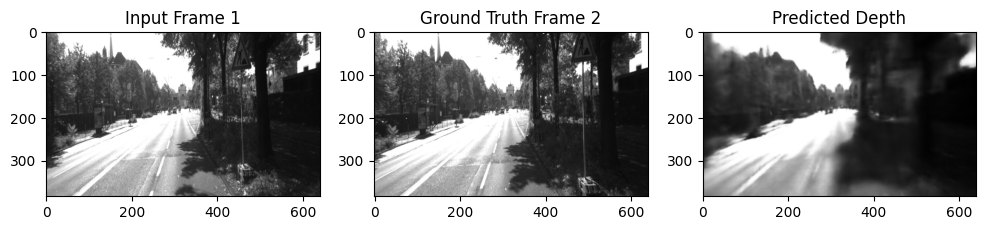

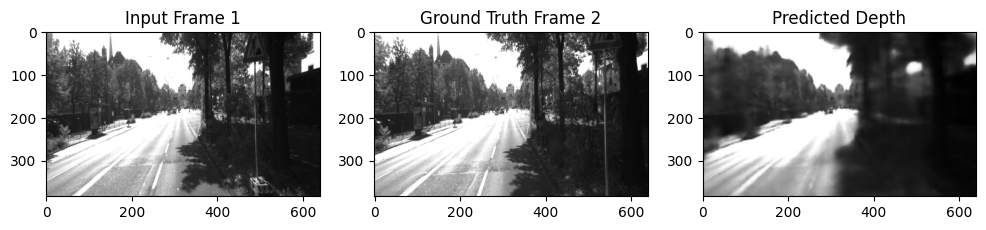

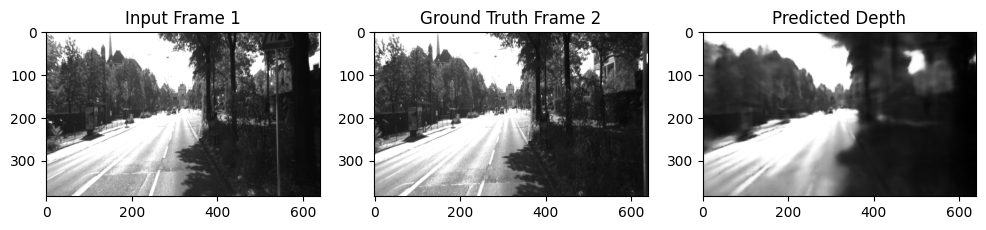

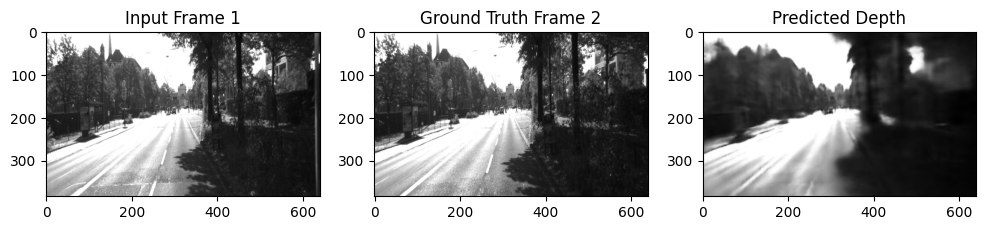

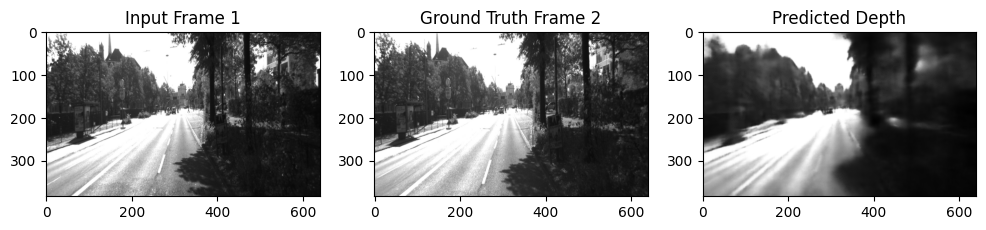

...

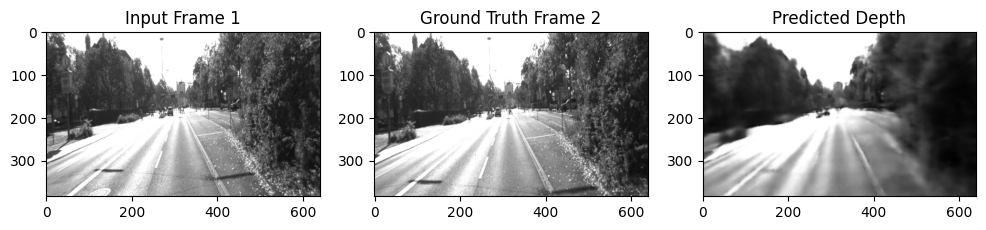

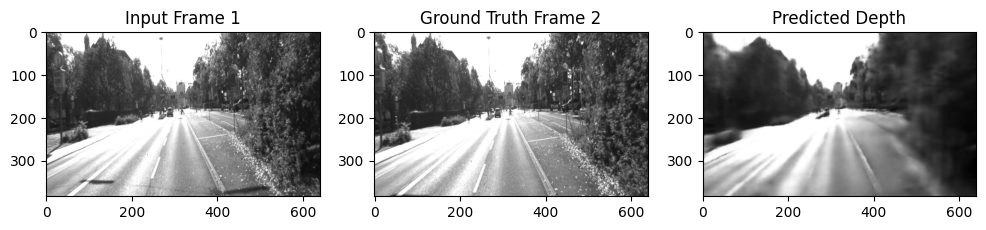

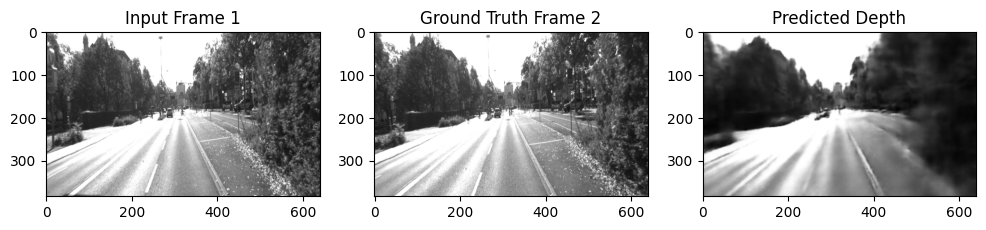

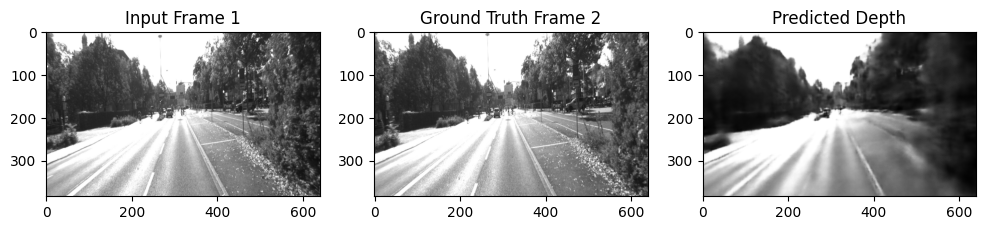

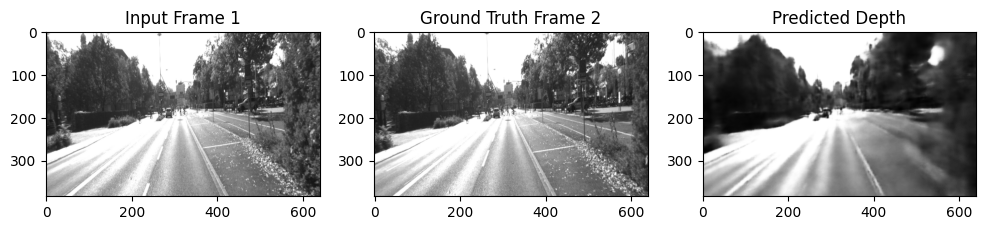

In [ ]:
def test_model(model, test_loader, device='cuda'):
    """
    Test the model and visualize the outputs.

    Args:
    - model: Trained PyTorch model
    - test_loader: DataLoader for test data
    - device: Device to test on (cuda/cpu)
    """
    model.eval()  # Set model to evaluation mode
    model.to(device)

    with torch.no_grad():
        for i, (frame1, frame2) in enumerate(test_loader):
            # Move data to device
            frame1, frame2 = frame1.to(device), frame2.to(device)

            # Forward pass
            depth = model(frame1)

            # Visualize the results
            visualize_results(frame1, frame2, depth)

            # Break after a few examples
            if i == 2:
                break

def visualize_results(frame1, frame2, depth):
    """
    Visualize the input frames and the depth output.

    Args:
    - frame1: Input frame
    - frame2: Ground truth frame
    - depth: Predicted depth
    """
    # Convert tensors to numpy arrays
    frame1_np = frame1.cpu().numpy().transpose(0, 2, 3, 1)
    frame2_np = frame2.cpu().numpy().transpose(0, 2, 3, 1)
    depth_np = depth.cpu().numpy().transpose(0, 2, 3, 1)

    # Plot the images
    for i in range(frame1_np.shape[0]):
        plt.figure(figsize=(12, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(frame1_np[i])
        plt.title('Input Frame 1')

        plt.subplot(1, 3, 2)
        plt.imshow(frame2_np[i])
        plt.title('Ground Truth Frame 2')

        plt.subplot(1, 3, 3)
        plt.imshow(depth_np[i].squeeze(), cmap='gray')
        plt.title('Predicted Depth')

        plt.show()

# Example usage
# Initialize test DataLoader
test_dataset = KITTISequentialDataset(data_dir)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, num_workers=2)

# Test the model
test_model(model, test_loader, device=device)

### Displaying loss plot of self-supervised learning

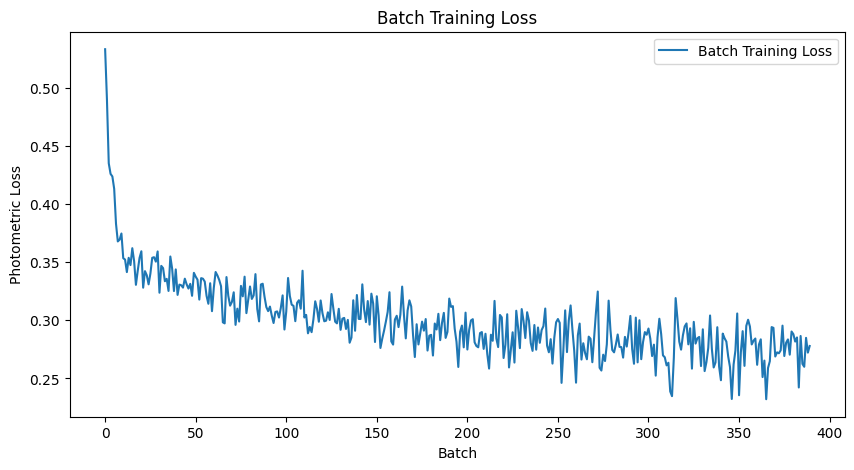

In [ ]:
save_dir = '/content'
os.makedirs(save_dir, exist_ok=True)

batch_loss_df = pd.read_csv("/content/batch_loss_history.csv")

plt.figure(figsize=(10, 5))
plt.plot(batch_loss_df['batch_loss'], label='Batch Training Loss')
plt.title('Batch Training Loss')
plt.xlabel('Batch')
plt.ylabel('Photometric Loss')
plt.legend()
plt.savefig(os.path.join(save_dir, 'self_supervised_training_curves.png'))

### Saving important files to drive

In [ ]:
!cp content/train_history.csv /content/drive/MyDrive/DeepLearning_Dataset
!cp content/depth_estimation_model.pth /content/drive/MyDrive/DeepLearning_Dataset

## Supervised Fine-Tuning

### Dataset Preparation

In [ ]:
!unzip /content/drive/MyDrive/DeepLearning/dataset_project/kitti-depth-completion.zip

流式输出内容被截断，只能显示最后 5000 行内容。
  inflating: valid/raw_kitti_data/2011_09_26/2011_09_26_drive_0036_sync/image_02/data/0000000092.png  
  inflating: valid/raw_kitti_data/2011_09_26/2011_09_26_drive_0036_sync/image_02/data/0000000093.png  
  inflating: valid/raw_kitti_data/2011_09_26/2011_09_26_drive_0036_sync/image_02/data/0000000094.png  
  inflating: valid/raw_kitti_data/2011_09_26/2011_09_26_drive_0036_sync/image_02/data/0000000095.png  
  inflating: valid/raw_kitti_data/2011_09_26/2011_09_26_drive_0036_sync/image_02/data/0000000096.png  
  inflating: valid/raw_kitti_data/2011_09_26/2011_09_26_drive_0036_sync/image_02/data/0000000097.png  
  inflating: valid/raw_kitti_data/2011_09_26/2011_09_26_drive_0036_sync/image_02/data/0000000098.png  
  inflating: valid/raw_kitti_data/2011_09_26/2011_09_26_drive_0036_sync/image_02/data/0000000099.png  
  inflating: valid/raw_kitti_data/2011_09_26/2011_09_26_drive_0036_sync/image_02/data/0000000100.png  
  inflating: valid/raw_kitti_data/2011_09_26/2

In [ ]:
import os

def list_files_sorted(start_path):
    for root, dirs, files in os.walk(start_path):
        dirs.sort()  # Sort directories
        files.sort()  # Sort files
        print(f"Directory: {root}")
        for file in files:
            print(f"  File: {file}")

# Example usage
start_path = '/content/train/data_depth_annotated/train'
list_files_sorted(start_path)

流式输出内容被截断，只能显示最后 5000 行内容。
  File: 0000001983.png
  File: 0000001984.png
  File: 0000001985.png
  File: 0000001986.png
  File: 0000001987.png
  File: 0000001988.png
  File: 0000001989.png
  File: 0000001990.png
  File: 0000001991.png
  File: 0000001992.png
  File: 0000001993.png
  File: 0000001994.png
  File: 0000001995.png
  File: 0000001996.png
  File: 0000001997.png
  File: 0000001998.png
  File: 0000001999.png
  File: 0000002000.png
  File: 0000002001.png
  File: 0000002002.png
  File: 0000002003.png
  File: 0000002004.png
  File: 0000002005.png
  File: 0000002006.png
  File: 0000002007.png
  File: 0000002008.png
  File: 0000002009.png
  File: 0000002010.png
  File: 0000002011.png
  File: 0000002012.png
  File: 0000002013.png
  File: 0000002014.png
  File: 0000002015.png
  File: 0000002016.png
  File: 0000002017.png
  File: 0000002018.png
  File: 0000002019.png
  File: 0000002020.png
  File: 0000002021.png
  File: 0000002022.png
  File: 0000002023.png
  File: 0000002024.png
  File:

In [ ]:
def list_files_sorted(start_path):
    for root, dirs, files in os.walk(start_path):
        dirs.sort()  # Sort directories
        files.sort()  # Sort files
        for file in files:
            full_path = os.path.join(root, file)
            print(f"  File: {full_path}")

# Example usage
start_path = '/content/train/raw_kitti_data'
list_files_sorted(start_path)

流式输出内容被截断，只能显示最后 5000 行内容。
  File: /content/train/raw_kitti_data/2011_10_03/2011_10_03_drive_0034_sync/image_03/data/0000001978.png
  File: /content/train/raw_kitti_data/2011_10_03/2011_10_03_drive_0034_sync/image_03/data/0000001979.png
  File: /content/train/raw_kitti_data/2011_10_03/2011_10_03_drive_0034_sync/image_03/data/0000001980.png
  File: /content/train/raw_kitti_data/2011_10_03/2011_10_03_drive_0034_sync/image_03/data/0000001981.png
  File: /content/train/raw_kitti_data/2011_10_03/2011_10_03_drive_0034_sync/image_03/data/0000001982.png
  File: /content/train/raw_kitti_data/2011_10_03/2011_10_03_drive_0034_sync/image_03/data/0000001983.png
  File: /content/train/raw_kitti_data/2011_10_03/2011_10_03_drive_0034_sync/image_03/data/0000001984.png
  File: /content/train/raw_kitti_data/2011_10_03/2011_10_03_drive_0034_sync/image_03/data/0000001985.png
  File: /content/train/raw_kitti_data/2011_10_03/2011_10_03_drive_0034_sync/image_03/data/0000001986.png
  File: /content/train/raw_k

In [ ]:
def print_directory_structure(rootdir):
    for dirpath, dirnames, filenames in os.walk(rootdir):
        level = dirpath.replace(rootdir, '').count(os.sep)
        indent = ' ' * 4 * level
        print(f'{indent}{os.path.basename(dirpath)}/')
        subindent = ' ' * 4 * (level + 1)
        for f in filenames:
            print(f'{subindent}{f}')

print_directory_structure('raw_kitti_data')

### Creating dataset class for Supervised Fine-Tuning

In [ ]:
class KITTISupervisedDataset(Dataset):
    def __init__(self, data_dir, depth_dir, image_size=(384, 640)):
        self.data_dir = data_dir
        self.depth_dir = depth_dir
        self.image_size = image_size
        self.image_depth_pairs = self._load_pairs()

    def _load_pairs(self):
        # Collect image files using glob
        image_pattern = os.path.join(self.data_dir, '**', '*.png')
        image_files = glob(image_pattern, recursive=True)
        image_files = natsort.natsorted(image_files)

        # Collect depth files using glob
        depth_pattern = os.path.join(self.depth_dir, '**', '*.png')
        depth_files = glob(depth_pattern, recursive=True)
        depth_files = natsort.natsorted(depth_files)

        # Ensure both lists are the same length
        assert len(image_files) == len(depth_files), "Mismatch in number of images and depth maps"

        # Pair images and depth maps by order
        pairs = list(zip(image_files, depth_files))
        return pairs

    def __len__(self):
        return len(self.image_depth_pairs)

    def __getitem__(self, idx):
        img_path, depth_path = self.image_depth_pairs[idx]

        # Load and preprocess RGB image
        image = cv2.imread(img_path)
        image = cv2.resize(image, self.image_size[::-1])
        image = image / 255.0  # Normalize to [0,1]
        image = np.transpose(image, (2, 0, 1))  # Channels first

        # Load and preprocess depth map
        depth = cv2.imread(depth_path, cv2.IMREAD_UNCHANGED)
        depth = cv2.resize(depth, self.image_size[::-1])
        depth = depth / depth.max()  # Normalize depth values
        depth = depth[np.newaxis, ...]  # Add channel dimension

        return torch.FloatTensor(image), torch.FloatTensor(depth)

    def print_pairs(self):
        for img_path, depth_path in self.image_depth_pairs:
            print(f"Image: {img_path}, Depth: {depth_path}")

In [ ]:
train_data_dir = '/content/train/raw_kitti_data'
train_depth_dir = '/content/train/data_depth_annotated/train'
val_data_dir = '/content/valid/raw_kitti_data'
val_depth_dir = '/content/valid/data_depth_annotated/val'
dataset_train = KITTISupervisedDataset(train_data_dir, train_depth_dir)
dataset_val = KITTISupervisedDataset(val_data_dir, val_depth_dir)

In [ ]:
dataset_train.print_pairs()

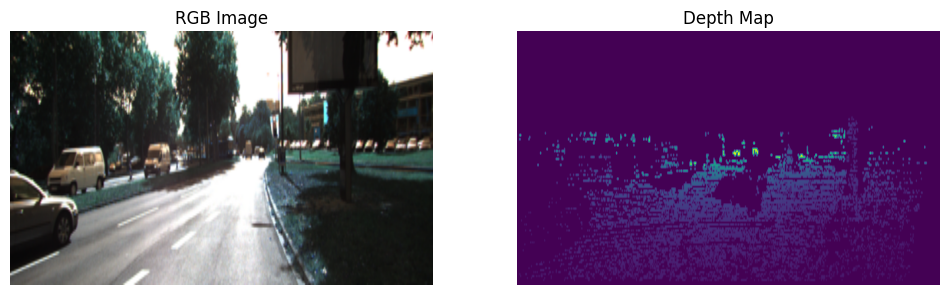

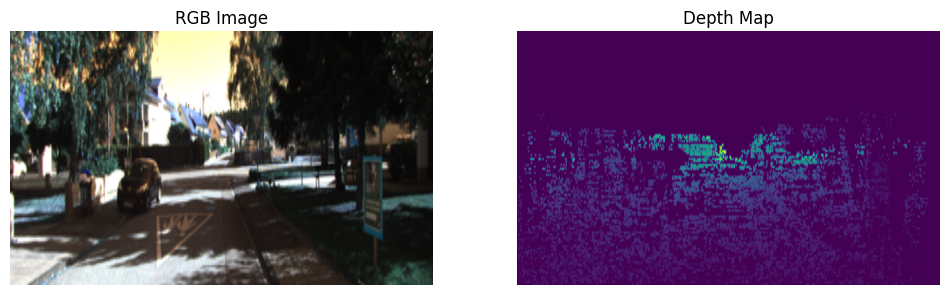

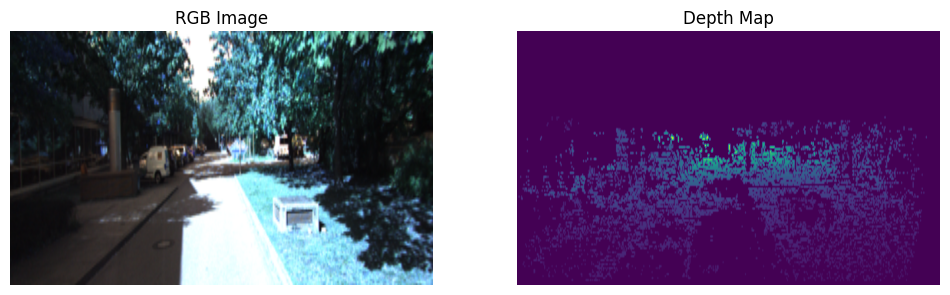

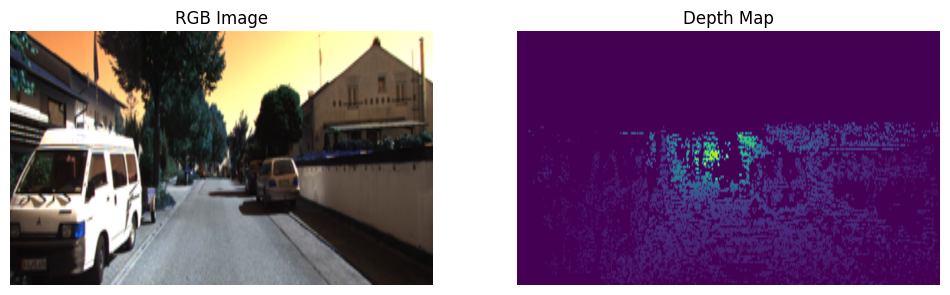

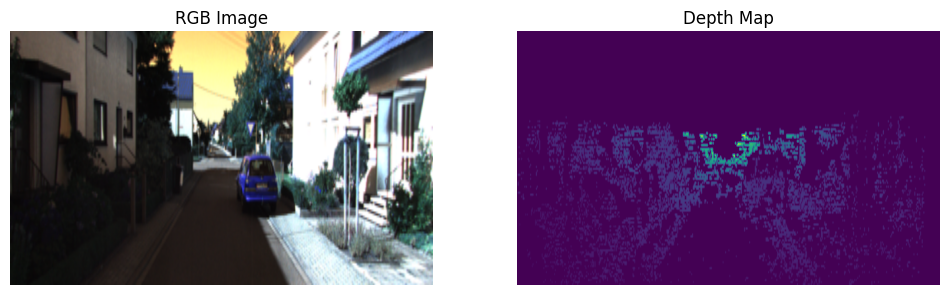

...

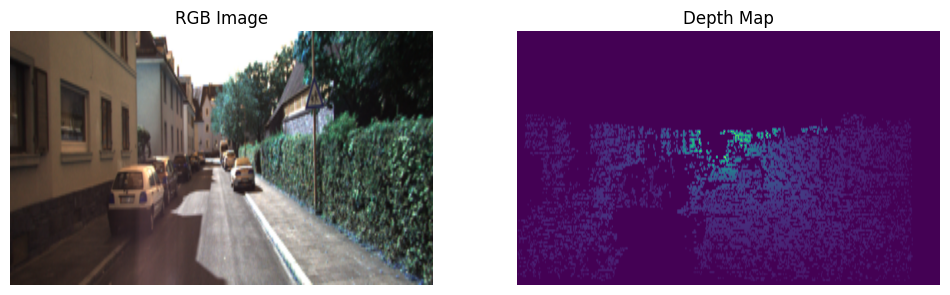

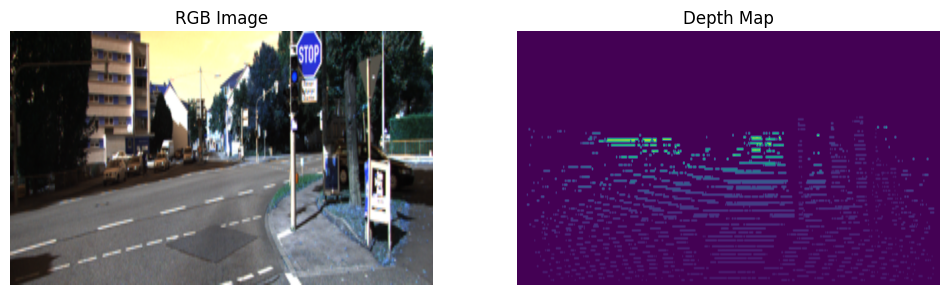

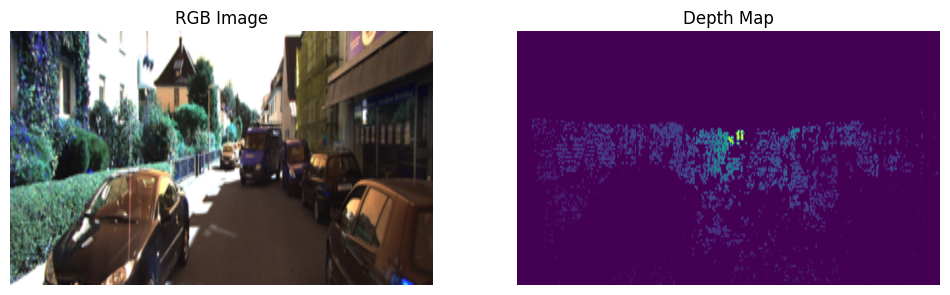

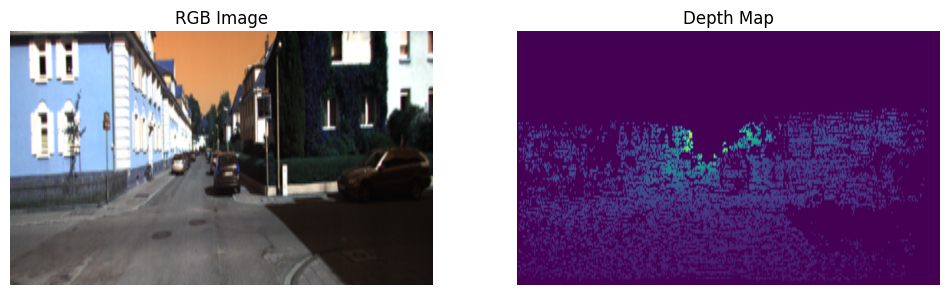

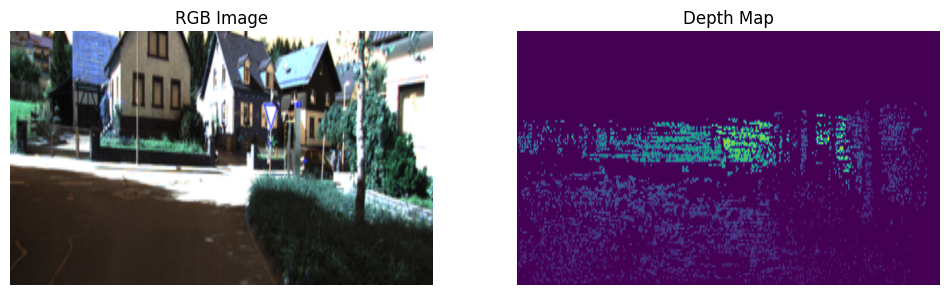

KeyboardInterrupt: 

In [ ]:
def show_image_and_depth(image, depth):
    # Convert the image and depth tensors to numpy arrays
    image = image.numpy().transpose(1, 2, 0)  # Convert to HWC
    depth = depth.numpy().squeeze(0)  # Remove channel dimension

    # Plot the image and depth side by side
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    axs[0].imshow(image)
    axs[0].set_title('RGB Image')
    axs[0].axis('off')

    axs[1].imshow(depth, cmap='viridis')
    axs[1].set_title('Depth Map')
    axs[1].axis('off')

    plt.show()

# Example usage
for i, (images, depths) in enumerate(dataloader_train):
    # Display the first batch
    for j in range(len(images)):
        show_image_and_depth(images[j], depths[j])
    break  # Only show the first batch

In [ ]:
dataloader_train = DataLoader(dataset_train, batch_size=64, shuffle=True)
dataloader_val = DataLoader(dataset_val, batch_size=64, shuffle=False)

### Supervised Depth Loss class

In [ ]:
class SupervisedDepthLoss(nn.Module):
    def __init__(self):
        super(SupervisedDepthLoss, self).__init__()

    def forward(self, pred, target):
        # L1 loss
        l1_loss = torch.mean(torch.abs(pred - target))

        # Scale-invariant loss
        d = torch.log(pred + 1e-6) - torch.log(target + 1e-6)  # Adding epsilon for numerical stability
        scale_invariant_loss = torch.sqrt(torch.mean(d ** 2) - 0.5 * (torch.mean(d) ** 2))

        # Gradient loss
        grad_pred = self._gradient(pred)
        grad_target = self._gradient(target)
        gradient_loss = torch.mean(torch.abs(grad_pred - grad_target))

        return l1_loss + 0.5 * scale_invariant_loss + 0.5 * gradient_loss

    def _gradient(self, depth):
        dy = depth[:, :, 1:, :] - depth[:, :, :-1, :]
        dx = depth[:, :, :, 1:] - depth[:, :, :, :-1]

        # Ensure consistent dimensions by slicing to the minimum size
        min_height = min(dy.size(2), dx.size(2))
        min_width = min(dy.size(3), dx.size(3))

        dy = dy[:, :, :min_height, :min_width]
        dx = dx[:, :, :min_height, :min_width]

        return torch.cat([dx.abs().mean(1, keepdim=True),
                          dy.abs().mean(1, keepdim=True)], dim=1)

### Supervised training function

In [ ]:
def train_supervised(model, train_loader, val_loader, num_epochs, device):
    """
    Fine-tune the model with supervised learning using ground truth depth
    """
    criterion = SupervisedDepthLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5)

    best_val_loss = float('inf')
    training_history = {
        'train_loss': [],
        'val_loss': [],
        'batch_loss': []  # Add this line to track batch loss
    }

    for epoch in range(num_epochs):
        # Training phase
        model.train()
        train_loss = 0
        batch_losses = []  # Initialize a list to store batch losses

        with tqdm(train_loader, desc=f'Epoch {epoch+1}/{num_epochs}') as pbar:
            for batch_idx, (images, depths) in enumerate(pbar):
                images, depths = images.to(device), depths.to(device)

                optimizer.zero_grad()
                pred_depths = model(images)
                loss = criterion(pred_depths, depths)

                loss.backward()
                optimizer.step()

                train_loss += loss.item()

                # Save batch loss every 100 batches
                if (batch_idx + 1) % 10 == 0:
                    batch_losses.append(loss.item())  # Store the batch loss

                pbar.set_postfix({'Loss': f'{loss.item():.4f}'})

        avg_train_loss = train_loss / len(train_loader)
        training_history['train_loss'].append(avg_train_loss)
        training_history['batch_loss'].append(batch_losses)  # Save batch losses

        # Validation phase
        model.eval()
        val_loss = 0

        with torch.no_grad():
            for images, depths in val_loader:
                images, depths = images.to(device), depths.to(device)
                pred_depths = model(images)
                loss = criterion(pred_depths, depths)
                val_loss += loss.item()

        avg_val_loss = val_loss / len(val_loader)
        training_history['val_loss'].append(avg_val_loss)

        # Learning rate scheduling
        scheduler.step(avg_val_loss)

        # Save best model
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            best_model_path = os.path.join('/content/drive/MyDrive/DeepLearning/project', 'best_supervised_model.pth')
            torch.save(model.state_dict(), best_model_path)

        print(f'Epoch {epoch+1}/{num_epochs}:')
        print(f'Train Loss: {avg_train_loss:.4f}')
        print(f'Val Loss: {avg_val_loss:.4f}')

    return model, training_history

In [ ]:
model = DepthNet()
model.load_state_dict(torch.load('/content/drive/MyDrive/DeepLearning/project/depth_estimation_model.pth'))

<ipython-input-31-ccdd95375c5d>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('/content/drive/MyDrive/DeepLearning/project/depth_estimati

<All keys matched successfully>

### Supervised Training over 10 epochs

In [ ]:
# Train model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

model, history = train_supervised(
    model=model,
    train_loader=dataloader_train,
    val_loader=dataloader_val,
    num_epochs=10,
    device=device
)

Epoch 1/10: 100%|██████████| 1343/1343 [1:00:26<00:00,  2.70s/it, Loss=2.0062]


Epoch 1/10:
Train Loss: 2.5604
Val Loss: 2.0346


Epoch 2/10: 100%|██████████| 1343/1343 [59:52<00:00,  2.68s/it, Loss=1.8649]


Epoch 2/10:
Train Loss: 1.9610
Val Loss: 2.0091


Epoch 3/10: 100%|██████████| 1343/1343 [1:00:28<00:00,  2.70s/it, Loss=1.8753]


Epoch 3/10:
Train Loss: 1.9116
Val Loss: 2.0231


Epoch 4/10: 100%|██████████| 1343/1343 [1:00:12<00:00,  2.69s/it, Loss=2.0303]


Epoch 4/10:
Train Loss: 1.8835
Val Loss: 2.0110


Epoch 5/10: 100%|██████████| 1343/1343 [1:00:18<00:00,  2.69s/it, Loss=1.8752]


Epoch 5/10:
Train Loss: 1.8638
Val Loss: 2.0114


Epoch 6/10: 100%|██████████| 1343/1343 [1:00:16<00:00,  2.69s/it, Loss=1.8397]


Epoch 6/10:
Train Loss: 1.8485
Val Loss: 2.0161


Epoch 7/10: 100%|██████████| 1343/1343 [1:00:07<00:00,  2.69s/it, Loss=1.7516]


Epoch 7/10:
Train Loss: 1.8362
Val Loss: 2.0388


Epoch 8/10: 100%|██████████| 1343/1343 [1:00:12<00:00,  2.69s/it, Loss=1.8756]


Epoch 8/10:
Train Loss: 1.8264
Val Loss: 2.0169


Epoch 9/10: 100%|██████████| 1343/1343 [1:00:15<00:00,  2.69s/it, Loss=1.8824]


Epoch 9/10:
Train Loss: 1.8015
Val Loss: 2.0054


Epoch 10/10: 100%|██████████| 1343/1343 [1:00:05<00:00,  2.68s/it, Loss=1.6138]


Epoch 10/10:
Train Loss: 1.7976
Val Loss: 2.0059


In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt

save_dir = '/content/drive/MyDrive/DeepLearning/history of supervised model'
os.makedirs(save_dir, exist_ok=True)

train_loss_df = pd.DataFrame({'train_loss': history['train_loss']})
val_loss_df = pd.DataFrame({'val_loss': history['val_loss']})
batch_loss_df = pd.DataFrame({'batch_loss': history['batch_loss']})

train_loss_df.to_csv(os.path.join(save_dir, 'train_loss_history.csv'), index=False)
val_loss_df.to_csv(os.path.join(save_dir, 'val_loss_history.csv'), index=False)
batch_loss_df.to_csv(os.path.join(save_dir, 'batch_loss_history.csv'), index=False)

plt.figure(figsize=(10, 5))
plt.plot(history['train_loss'], label='Training Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.savefig(os.path.join(save_dir, 'supervised_training_curves.png'))
plt.close()

In [ ]:
batch_loss_df

,batch_loss
0,"[3.548175096511841, 3.491241216659546, 3.45619..."
1,"[3.202483654022217, 3.181405544281006, 3.15063..."


### Visualizing final results

<ipython-input-9-cc230a9a2b47>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('/content/drive/MyDrive/DeepLearning/project/best_supervised

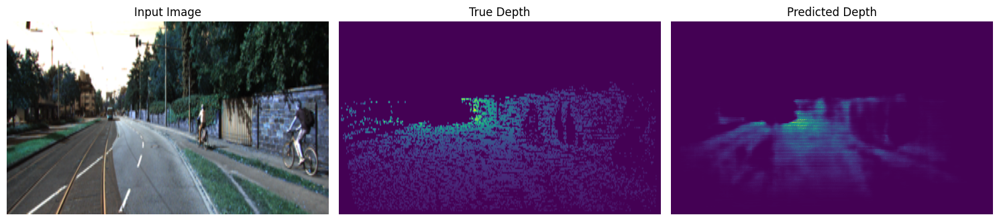

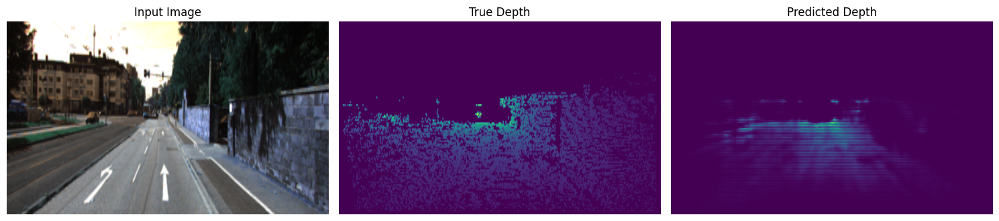

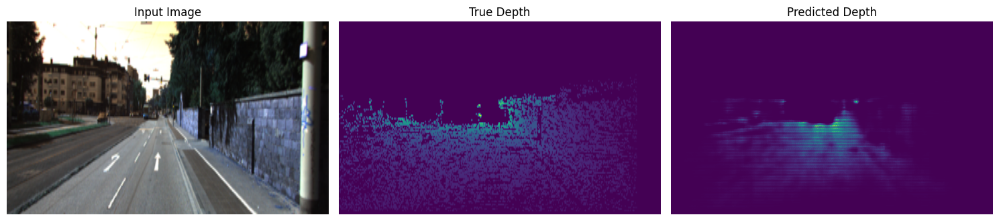

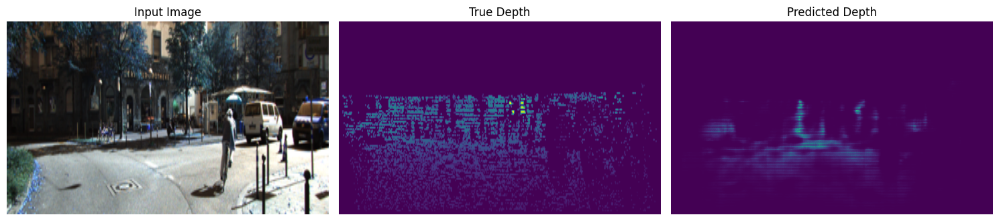

In [ ]:
model = DepthNet()
model.load_state_dict(torch.load('/content/drive/MyDrive/DeepLearning/project/best_supervised_model.pth'))

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
model.eval()
import matplotlib.pyplot as plt
import numpy as np

def visualize_results(images, depths, predicted_depths):
    # Move tensors to CPU and convert to numpy arrays
    images = images.cpu().numpy()
    depths = depths.cpu().numpy()
    predicted_depths = predicted_depths.cpu().numpy()

    # Assuming batch size of 1 for simplicity
    image = np.transpose(images[0], (1, 2, 0))  # Convert from CHW to HWC
    depth = depths[0, 0]  # Assuming depth is single channel
    predicted_depth = predicted_depths[0, 0]  # Assuming depth is single channel

    # Plot the results
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    ax[0].imshow(image)
    ax[0].set_title('Input Image')
    ax[0].axis('off')

    ax[1].imshow(depth, cmap='viridis')
    ax[1].set_title('True Depth')
    ax[1].axis('off')

    ax[2].imshow(predicted_depth, cmap='viridis')
    ax[2].set_title('Predicted Depth')
    ax[2].axis('off')

    plt.tight_layout()
    plt.show()
with torch.no_grad():
    for i, (images, depths) in enumerate(dataloader_val):
        images, depths = images.to(device), depths.to(device)
        predicted_depths = model(images)

        # Visualize or process the results
        # Example using visualize_results function (assuming it's defined)
        visualize_results(images, depths, predicted_depths)

        if i == 3:  # Limit to a few examples for testing
            break

### Inferencing depthnet on traffic images for demonstration purposes

In [ ]:
model = DepthNet()
model.load_state_dict(torch.load('/content/drive/MyDrive/DeepLearning/project/best_supervised_model.pth'))

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

<ipython-input-7-5e115b9e5d25>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('/content/drive/MyDrive/DeepLearning/project/best_supervised

In [ ]:
import cv2
import torch
from torch.utils.data import DataLoader
import numpy as np
from tqdm import tqdm

# Define your DataLoader
dataloader_train = DataLoader(dataset_train, batch_size=1, shuffle=False)

# Prepare the model for evaluation
model.eval()

# Define video writer
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('depth_video.avi', fourcc, 20.0, (3 * dataset_train.image_size[1], dataset_train.image_size[0]))

# Process only 100 frames
frame_count = 0
max_frames = 1000

with torch.no_grad():
    for images, depths in tqdm(dataloader_train):
        if frame_count >= max_frames:
            break

        images = images.to(device)
        depths = depths.to(device)

        # Get model predictions
        outputs = model(images)

        # Move tensors to CPU and convert to numpy
        images_np = images.cpu().numpy().squeeze().transpose(1, 2, 0)
        depths_np = depths.cpu().numpy().squeeze()
        outputs_np = outputs.cpu().numpy().squeeze()

        # Normalize images for display
        images_np = (images_np * 255).astype(np.uint8)
        depths_np = (depths_np * 255).astype(np.uint8)
        outputs_np = (outputs_np * 255).astype(np.uint8)

        # Convert depth maps to 3-channel images
        depths_color = cv2.applyColorMap(depths_np, cv2.COLORMAP_JET)
        outputs_color = cv2.applyColorMap(outputs_np, cv2.COLORMAP_JET)

        # Concatenate images horizontally
        combined_frame = np.concatenate((images_np, depths_color, outputs_color), axis=1)

        # Write frame to video
        out.write(combined_frame)

        frame_count += 1

# Release the video writer
out.release()

  1%|          | 1000/85898 [00:39<55:36, 25.44it/s]


### Utility cells to clear up GPU RAM

In [ ]:
del dataloader_train
del dataloader_val
torch.cuda.empty_cache()

In [ ]:
!fuser -v /dev/nvidia*

                     USER        PID ACCESS COMMAND
/dev/nvidia0:        root        177 F...m python3
/dev/nvidiactl:      root        177 F...m python3
/dev/nvidia-uvm:     root        177 F...m python3


In [ ]:
!sudo fuser -v /dev/nvidia* |awk '{for(i=1;i<=NF;i++)print "kill -9 " $i;}' | sudo sh